# USAD

## Environment

In [1]:
!rm -r sample_data

rm: cannot remove 'sample_data': No such file or directory


In [2]:
!git clone https://github.com/manigalati/usad

In [3]:
%cd usad

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import torch.nn as nn

from utils import *
from usad import *

In [3]:
!nvidia-smi -L

device = get_default_device()

GPU 0: NVIDIA GeForce GTX 1080 Ti (UUID: GPU-544ce3d5-6b82-7735-9697-1b5de62c925b)
GPU 1: NVIDIA GeForce GTX 1080 Ti (UUID: GPU-dcaf0d0d-7c21-a1fb-2639-e92e3b7923e7)
GPU 2: NVIDIA GeForce GTX 1080 Ti (UUID: GPU-f5091519-619d-14a3-8e35-02955c8bb015)
GPU 3: NVIDIA GeForce GTX 1080 Ti (UUID: GPU-a2c0b088-874d-2aa5-2282-ae85dca0d486)


## EDA - Data Pre-Processing

### Download dataset

In [3]:
!mkdir input
#normal period
!python gdrivedl.py https://drive.google.com/open?id=1rVJ5ry5GG-ZZi5yI4x9lICB8VhErXwCw input/
#anomalies
!python gdrivedl.py https://drive.google.com/open?id=1iDYc0OEmidN712fquOBRFjln90SbpaE7 input/

input/SWaT_Dataset_Normal_v1.csv
[                                                  ] 0.00MB/163.77MB
input/SWaT_Dataset_Attack_v0.csv
[                                                  ] 0.00MB/127.27MB


### Normal period

In [4]:
#Read data
normal = pd.read_csv("data/SWaT_Dataset_Normal_v1.csv")#, nrows=1000)
normal = normal.drop(["Timestamp" , "Normal/Attack" ] , axis = 1)
normal.shape

/tmp/ipykernel_14331/1496298649.py:2: DtypeWarning: Columns (26) have mixed types. Specify dtype option on import or set low_memory=False.
  normal = pd.read_csv("data/SWaT_Dataset_Normal_v1.csv")#, nrows=1000)


(495000, 51)

In [5]:
normal

,FIT101,LIT101,MV101,P101,P102,AIT201,AIT202,AIT203,FIT201,MV201,...,FIT504,P501,P502,PIT501,PIT502,PIT503,FIT601,P601,P602,P603
0,0,"124,3135",1,1,1,"251,9226","8,313446","312,7916",0,1,...,0,1,1,"9,100231",0,"3,3485","0,0002563035",1,1,1
1,0,"124,392",1,1,1,"251,9226","8,313446","312,7916",0,1,...,0,1,1,"9,100231",0,"3,3485","0,0002563035",1,1,1
2,0,"124,4705",1,1,1,"251,9226","8,313446","312,7916",0,1,...,0,1,1,"9,100231",0,"3,3485","0,0002563035",1,1,1
3,0,"124,6668",1,1,1,"251,9226","8,313446","312,7916",0,1,...,0,1,1,"9,100231",0,"3,3485","0,0002563035",1,1,1
4,0,"124,5098",1,1,1,"251,9226","8,313446","312,7916",0,1,...,0,1,1,"9,100231",0,"3,3485","0,0002563035",1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
494995,"2,460366","523,043",2,2,1,"262,0161","8,396437","328,5055","2,442316",2,...,"0,3086186",2,1,"250,8171","1,778105","189,8552","0,0001281517",1,1,1
494996,"2,448836","522,9645",2,2,1,"262,0161","8,396437","328,5055","2,442316",2,...,"0,3086186",2,1,"250,8171","1,778105","189,5027","0,0001281517",1,1,1
494997,"2,434744","522,886",2,2,1,"262,0161","8,396437","328,6337","2,444879",2,...,"0,3086186",2,1,"250,8171","1,778105","189,5027","0,0001281517",1,1,1
494998,"2,428338","522,9252",2,2,1,"262,0161","8,396437","328,6337","2,445391",2,...,"0,3086186",2,1,"250,8171","1,649953","189,5027","0,0001281517",1,1,1


In [6]:
# Transform all columns into float64
for i in list(normal): 
    normal[i]=normal[i].apply(lambda x: str(x).replace("," , "."))
normal = normal.astype(float)

#### Normalization

In [7]:
from sklearn import preprocessing
min_max_scaler = preprocessing.MinMaxScaler()

x = normal.values
x_scaled = min_max_scaler.fit_transform(x)
normal = pd.DataFrame(x_scaled)

In [8]:
normal

,0,1,2,3,4,5,6,7,8,9,...,41,42,43,44,45,46,47,48,49,50
0,0.000000,0.005294,0.5,0.0,0.0,0.012291,0.075099,0.002009,0.000000,0.5,...,0.000000,0.0,0.0,0.000814,0.000000,0.001217,0.000147,0.0,0.0,0.0
1,0.000000,0.005407,0.5,0.0,0.0,0.012291,0.075099,0.002009,0.000000,0.5,...,0.000000,0.0,0.0,0.000814,0.000000,0.001217,0.000147,0.0,0.0,0.0
2,0.000000,0.005520,0.5,0.0,0.0,0.012291,0.075099,0.002009,0.000000,0.5,...,0.000000,0.0,0.0,0.000814,0.000000,0.001217,0.000147,0.0,0.0,0.0
3,0.000000,0.005801,0.5,0.0,0.0,0.012291,0.075099,0.002009,0.000000,0.5,...,0.000000,0.0,0.0,0.000814,0.000000,0.001217,0.000147,0.0,0.0,0.0
4,0.000000,0.005576,0.5,0.0,0.0,0.012291,0.075099,0.002009,0.000000,0.5,...,0.000000,0.0,0.0,0.000814,0.000000,0.001217,0.000147,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
494995,0.896278,0.577415,1.0,1.0,0.0,0.496158,0.188845,0.063586,0.981663,1.0,...,0.973530,1.0,0.0,0.945937,0.484716,0.945414,0.000073,0.0,0.0,0.0
494996,0.892078,0.577302,1.0,1.0,0.0,0.496158,0.188845,0.063586,0.981663,1.0,...,0.973530,1.0,0.0,0.945937,0.484716,0.943629,0.000073,0.0,0.0,0.0
494997,0.886944,0.577190,1.0,1.0,0.0,0.496158,0.188845,0.064088,0.982693,1.0,...,0.973530,1.0,0.0,0.945937,0.484716,0.943629,0.000073,0.0,0.0,0.0
494998,0.884611,0.577246,1.0,1.0,0.0,0.496158,0.188845,0.064088,0.982899,1.0,...,0.973530,1.0,0.0,0.945937,0.449782,0.943629,0.000073,0.0,0.0,0.0


### Attack

In [9]:
#Read data
attack = pd.read_csv("data/SWaT_Dataset_Attack_v0.csv",sep=";")#, nrows=1000)
labels = [ float(label!= 'Normal' ) for label  in attack["Normal/Attack"].values]
attack = attack.drop(["Timestamp" , "Normal/Attack" ] , axis = 1)
attack.shape

/tmp/ipykernel_14331/2629613335.py:2: DtypeWarning: Columns (1,9,28,46) have mixed types. Specify dtype option on import or set low_memory=False.
  attack = pd.read_csv("data/SWaT_Dataset_Attack_v0.csv",sep=";")#, nrows=1000)


(449919, 51)

In [10]:
attack

,FIT101,LIT101,MV101,P101,P102,AIT201,AIT202,AIT203,FIT201,MV201,...,FIT504,P501,P502,PIT501,PIT502,PIT503,FIT601,P601,P602,P603
0,"2,427057","522,8467",2,2,1,"262,0161","8,396437","328,6337","2,445391",2,...,"0,3077859",2,1,"250,8652","1,649953","189,5988","0,000128152",1,1,1
1,"2,446274","522,886",2,2,1,"262,0161","8,396437","328,6337","2,445391",2,...,"0,3077859",2,1,"250,8652","1,649953","189,6789","0,000128152",1,1,1
2,"2,489191","522,8467",2,2,1,"262,0161","8,394514","328,6337","2,442316",2,...,"0,3086186",2,1,"250,8812","1,649953","189,6789","0,000128152",1,1,1
3,"2,53435","522,9645",2,2,1,"262,0161","8,394514","328,6337","2,442316",2,...,"0,3086186",2,1,"250,8812","1,649953","189,6148","0,000128152",1,1,1
4,"2,56926","523,4748",2,2,1,"262,0161","8,394514","328,6337","2,443085",2,...,"0,3086186",2,1,"250,8812","1,649953","189,5027","0,000128152",1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
449914,"2,559972","519,5495",2,2,1,"168,0979","8,638683","301,9226","2,459488",2,...,"0,3065689",2,1,"251,1535","0,8650241","189,022",0,1,1,1
449915,"2,549082","520,4131",2,2,1,"168,0979","8,638683","301,9226","2,459488",2,...,"0,3065689",2,1,"251,0734","0,8650241","188,9259",0,1,1,1
449916,"2,531467","520,6878",2,2,1,"168,0979","8,638683","301,9226","2,460129",2,...,"0,3065689",2,1,"251,0734","0,8650241","188,9259",0,1,1,1
449917,"2,521218","520,7271",2,2,1,"168,0979","8,638683","301,9226","2,460129",2,...,"0,3079781",2,1,"251,0734","0,8650241","188,9259",0,1,1,1


In [11]:
labels

[0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0

In [13]:
label_df = pd.DataFrame(labels)
label_df[0].unique()

array([0., 1.])

In [14]:
label_df[0].sum(), len(label_df), label_df[0].sum() / len(label_df)

(54621.0, 449919, 0.12140185233342002)

In [15]:
# Transform all columns into float64
for i in list(attack):
    attack[i]=attack[i].apply(lambda x: str(x).replace("," , "."))
attack = attack.astype(float)

#### Normalization

In [16]:
from sklearn import preprocessing

x = attack.values 
x_scaled = min_max_scaler.transform(x)
attack = pd.DataFrame(x_scaled)

In [17]:
attack

,0,1,2,3,4,5,6,7,8,9,...,41,42,43,44,45,46,47,48,49,50
0,0.884144,0.577133,1.0,1.0,0.0,0.496158,0.188845,0.064088,0.982899,1.0,...,0.970903,1.0,0.0,0.946125,0.449782,0.944116,0.000073,0.0,0.0,0.0
1,0.891145,0.577190,1.0,1.0,0.0,0.496158,0.188845,0.064088,0.982899,1.0,...,0.970903,1.0,0.0,0.946125,0.449782,0.944521,0.000073,0.0,0.0,0.0
2,0.906779,0.577133,1.0,1.0,0.0,0.496158,0.186209,0.064088,0.981663,1.0,...,0.973530,1.0,0.0,0.946188,0.449782,0.944521,0.000073,0.0,0.0,0.0
3,0.923230,0.577302,1.0,1.0,0.0,0.496158,0.186209,0.064088,0.981663,1.0,...,0.973530,1.0,0.0,0.946188,0.449782,0.944197,0.000073,0.0,0.0,0.0
4,0.935947,0.578034,1.0,1.0,0.0,0.496158,0.186209,0.064088,0.981972,1.0,...,0.973530,1.0,0.0,0.946188,0.449782,0.943629,0.000073,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
449914,0.932563,0.572402,1.0,1.0,0.0,-4.006131,0.520861,-0.040583,0.988565,1.0,...,0.967064,1.0,0.0,0.947253,0.235808,0.941196,0.000000,0.0,0.0,0.0
449915,0.928596,0.573641,1.0,1.0,0.0,-4.006131,0.520861,-0.040583,0.988565,1.0,...,0.967064,1.0,0.0,0.946940,0.235808,0.940709,0.000000,0.0,0.0,0.0
449916,0.922179,0.574035,1.0,1.0,0.0,-4.006131,0.520861,-0.040583,0.988822,1.0,...,0.967064,1.0,0.0,0.946940,0.235808,0.940709,0.000000,0.0,0.0,0.0
449917,0.918446,0.574092,1.0,1.0,0.0,-4.006131,0.520861,-0.040583,0.988822,1.0,...,0.971509,1.0,0.0,0.946940,0.235808,0.940709,0.000000,0.0,0.0,0.0


### Windows

In [18]:
window_size=12

In [19]:
np.arange(window_size)[None, :]

array([[ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11]])

In [20]:
np.arange(normal.shape[0]-window_size)[:, None]

array([[     0],
       [     1],
       [     2],
       ...,
       [494985],
       [494986],
       [494987]])

In [21]:
np.arange(window_size)[None, :] + np.arange(normal.shape[0]-window_size)[:, None]
# In this way we select the indices to extract the windows ---> overlapping windows, stride = 1

array([[     0,      1,      2, ...,      9,     10,     11],
       [     1,      2,      3, ...,     10,     11,     12],
       [     2,      3,      4, ...,     11,     12,     13],
       ...,
       [494985, 494986, 494987, ..., 494994, 494995, 494996],
       [494986, 494987, 494988, ..., 494995, 494996, 494997],
       [494987, 494988, 494989, ..., 494996, 494997, 494998]])

In [22]:
windows_normal=normal.values[np.arange(window_size)[None, :] + np.arange(normal.shape[0]-window_size)[:, None]]
windows_normal.shape

(494988, 12, 51)

In [23]:
def windows(dataframe, window_size):
  total_length = dataframe.shape[0]
  output = []
  data = np.array(dataframe)
  for i in range(total_length - window_size + 1):
    # find the end of this sequence
    end_ix = i + window_size
    # check if we are beyond the dataset length for this building
    if end_ix > total_length-1:
      break
    output.append(data[i : (i + window_size),:])
  return np.stack(output)

In [24]:
try_windows_normal = windows(normal, window_size)
try_windows_normal.shape

(494988, 12, 51)

In [25]:
windows_normal

array([[[0.        , 0.00529434, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00540698, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00551961, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.        , 0.00388631, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.0044495 , 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00523795, 0.5       , ..., 0.        ,
         0.        , 0.        ]],

       [[0.        , 0.00540698, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00551961, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00580128, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.        , 0.0044495 , 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0. 

In [26]:
try_windows_normal

array([[[0.        , 0.00529434, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00540698, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00551961, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.        , 0.00388631, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.0044495 , 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00523795, 0.5       , ..., 0.        ,
         0.        , 0.        ]],

       [[0.        , 0.00540698, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00551961, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00580128, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.        , 0.0044495 , 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0. 

In [27]:
windows_attack=attack.values[np.arange(window_size)[None, :] + np.arange(attack.shape[0]-window_size)[:, None]]
windows_attack.shape

(449907, 12, 51)

In [28]:
windows_attack

array([[[0.88414414, 0.57713312, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.89114463, 0.57718951, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.90677872, 0.57713312, 1.        , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.96534834, 0.5788792 , 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.95823127, 0.57893544, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.95508092, 0.57842865, 1.        , ..., 0.        ,
         0.        , 0.        ]],

       [[0.89114463, 0.57718951, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.90677872, 0.57713312, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.92322953, 0.57730214, 1.        , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.95823127, 0.57893544, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.9

## Training

In [29]:
import torch.utils.data as data_utils

BATCH_SIZE =  7919
N_EPOCHS = 100
hidden_size = 100

w_size=windows_normal.shape[1]*windows_normal.shape[2] #12*51 = 612
z_size=windows_normal.shape[1]*hidden_size # 12*100 = 1200

#ENCODER:
#612 --> 306
#306 --> 153
#153 --> 1200

windows_normal_train = windows_normal[:int(np.floor(.8 *  windows_normal.shape[0]))]
windows_normal_val = windows_normal[int(np.floor(.8 *  windows_normal.shape[0])):int(np.floor(windows_normal.shape[0]))]

train_loader = torch.utils.data.DataLoader(data_utils.TensorDataset(
    torch.from_numpy(windows_normal_train).float().view(([windows_normal_train.shape[0],w_size]))
) , batch_size=BATCH_SIZE, shuffle=False, num_workers=0)

val_loader = torch.utils.data.DataLoader(data_utils.TensorDataset(
    torch.from_numpy(windows_normal_val).float().view(([windows_normal_val.shape[0],w_size]))
) , batch_size=BATCH_SIZE, shuffle=False, num_workers=0)

test_loader = torch.utils.data.DataLoader(data_utils.TensorDataset(
    torch.from_numpy(windows_attack).float().view(([windows_attack.shape[0],w_size]))
) , batch_size=BATCH_SIZE, shuffle=False, num_workers=0)

model = UsadModel(w_size, z_size)
model = to_device(model,device)

In [19]:
history = training(N_EPOCHS,model,train_loader,val_loader)

Epoch [0], val_loss1: 0.0261, val_loss2: 0.0263
Epoch [1], val_loss1: 0.0206, val_loss2: -0.0026
Epoch [2], val_loss1: 0.0323, val_loss2: -0.0210
Epoch [3], val_loss1: 0.0389, val_loss2: -0.0281
Epoch [4], val_loss1: 0.0423, val_loss2: -0.0310
Epoch [5], val_loss1: 0.0293, val_loss2: -0.0217
Epoch [6], val_loss1: 0.0593, val_loss2: -0.0476
Epoch [7], val_loss1: 0.0582, val_loss2: -0.0514
Epoch [8], val_loss1: 0.0588, val_loss2: -0.0537
Epoch [9], val_loss1: 0.0592, val_loss2: -0.0546
Epoch [10], val_loss1: 0.0595, val_loss2: -0.0554
Epoch [11], val_loss1: 0.0607, val_loss2: -0.0570
Epoch [12], val_loss1: 0.0629, val_loss2: -0.0594
Epoch [13], val_loss1: 0.0632, val_loss2: -0.0600
Epoch [14], val_loss1: 0.1583, val_loss2: -0.1409
Epoch [15], val_loss1: 0.1570, val_loss2: -0.1452
Epoch [16], val_loss1: 0.1564, val_loss2: -0.1460
Epoch [17], val_loss1: 0.1568, val_loss2: -0.1470
Epoch [18], val_loss1: 0.1573, val_loss2: -0.1481
Epoch [19], val_loss1: 0.1577, val_loss2: -0.1490
Epoch [20],

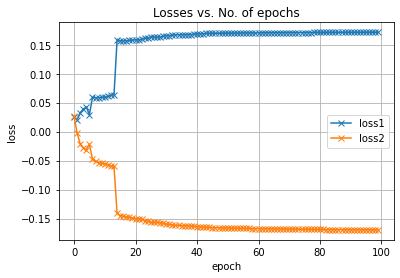

In [20]:
plot_history(history)

In [21]:
torch.save({
            'encoder': model.encoder.state_dict(),
            'decoder1': model.decoder1.state_dict(),
            'decoder2': model.decoder2.state_dict()
            }, "model.pth")

## Testing

In [30]:
checkpoint = torch.load("checkpoints/usad_model.pth")

model.encoder.load_state_dict(checkpoint['encoder'])
model.decoder1.load_state_dict(checkpoint['decoder1'])
model.decoder2.load_state_dict(checkpoint['decoder2'])

<All keys matched successfully>

In [31]:
results=testing(model,test_loader)

In [32]:
len(results)

57

In [33]:
len(results[0])

7919

In [34]:
results

[tensor([0.0595, 0.0595, 0.0595,  ..., 0.0323, 0.0323, 0.0323], device='cuda:0'),
 tensor([0.0324, 0.0323, 0.0323,  ..., 0.2139, 0.2142, 0.2145], device='cuda:0'),
 tensor([0.2148, 0.2151, 0.2154,  ..., 0.0595, 0.0595, 0.0595], device='cuda:0'),
 tensor([0.0596, 0.0596, 0.0596,  ..., 0.0599, 0.0599, 0.0599], device='cuda:0'),
 tensor([0.0599, 0.0599, 0.0599,  ..., 0.0600, 0.0601, 0.0601], device='cuda:0'),
 tensor([0.0602, 0.0602, 0.0602,  ..., 0.0966, 0.0966, 0.0966], device='cuda:0'),
 tensor([0.0965, 0.0965, 0.0964,  ..., 0.0660, 0.0670, 0.0672], device='cuda:0'),
 tensor([0.0675, 0.0680, 0.0687,  ..., 0.0304, 0.0304, 0.0304], device='cuda:0'),
 tensor([0.0304, 0.0304, 0.0304,  ..., 0.0616, 0.0617, 0.0617], device='cuda:0'),
 tensor([0.0617, 0.0617, 0.0617,  ..., 0.0601, 0.0601, 0.0601], device='cuda:0'),
 tensor([0.0602, 0.0602, 0.0603,  ..., 0.0602, 0.0601, 0.0600], device='cuda:0'),
 tensor([0.0599, 0.0599, 0.0599,  ..., 0.0606, 0.0606, 0.0607], device='cuda:0'),
 tensor([0.0607,

In [35]:
# Qui va ad ottenere le label per ogni finestra
# Input modello è una lista di array, ognuno corrispondente a una sliding window con stride = 1 sui dati originali
# Quindi dobbiamo applicare la sliding window anche sulle label
windows_labels=[]
for i in range(len(labels)-window_size):
    windows_labels.append(list(np.int_(labels[i:i+window_size])))

In [36]:
windows_labels

[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0,

In [37]:
y_test = [1.0 if (np.sum(window) > 0) else 0 for window in windows_labels ]
# Qui vado a dare le label 1 per ogni finestra: se tutta la finestra contiene label = 0, allora y_test(t) = 0, altrimenti = 1

In [38]:
print(y_test)

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

In [39]:
y_pred=np.concatenate([torch.stack(results[:-1]).flatten().detach().cpu().numpy(),
                              results[-1].flatten().detach().cpu().numpy()])

In [40]:
y_pred

array([0.05945569, 0.0594984 , 0.05954124, ..., 0.52025783, 0.5202203 ,
       0.52019626], dtype=float32)

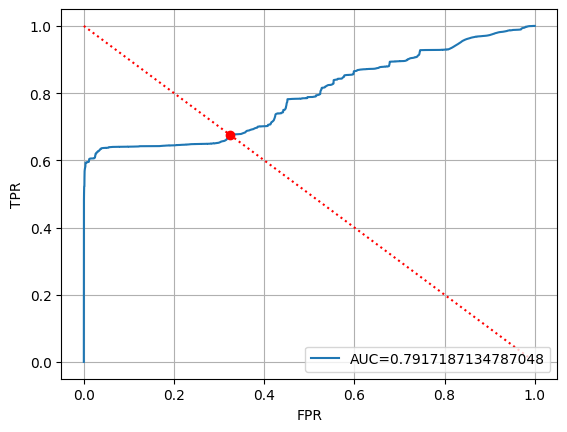

In [41]:
threshold=ROC(y_test,y_pred)

In [42]:
threshold

array([0.42196178], dtype=float32)

In [43]:
y_pred_ = np.zeros(y_pred.shape[0])

In [44]:
y_pred_[y_pred >= threshold] = 1

In [45]:
y_pred_

array([0., 0., 0., ..., 1., 1., 1.])

In [46]:
np.array(y_test)

array([0., 0., 0., ..., 0., 0., 0.])

In [47]:
import sklearn

In [48]:
sklearn.metrics.roc_auc_score(y_test, y_pred_)

0.6760608502736357

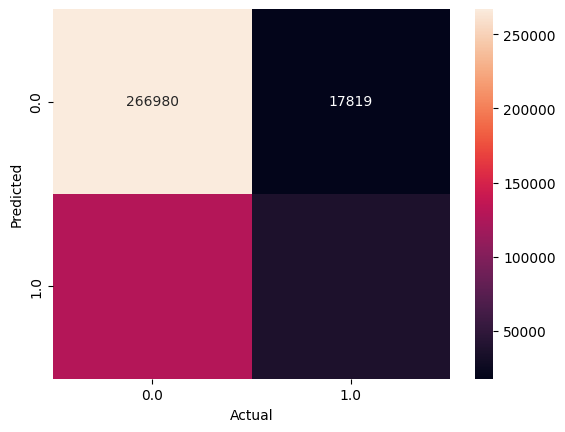

In [49]:
confusion_matrix(np.array(y_test), y_pred_)

In [50]:
print(sklearn.metrics.classification_report(y_test, y_pred_))

              precision    recall  f1-score   support

         0.0       0.94      0.68      0.79    394901
         1.0       0.23      0.68      0.34     55006

    accuracy                           0.68    449907
   macro avg       0.58      0.68      0.56    449907
weighted avg       0.85      0.68      0.73    449907



In [51]:
y_pred.min(), y_pred.max()

(0.02877604, 0.62046957)

In [52]:
threshold = np.percentile(y_pred, 93)
print(threshold)
y_pred_ = np.zeros(y_pred.shape[0])
y_pred_[y_pred >= threshold] = 1

0.5539354276657105


In [53]:
len(y_pred_)

449907

In [54]:
y_pred_.sum()

31494.0

In [55]:
y_pred_.sum()/len(y_pred_)

0.07000113356760397

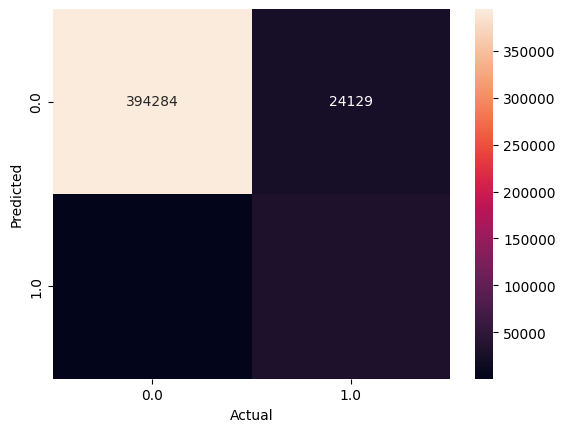

In [56]:
confusion_matrix(np.array(y_test), y_pred_)

In [57]:
print(sklearn.metrics.classification_report(y_test, y_pred_))

              precision    recall  f1-score   support

         0.0       0.94      1.00      0.97    394901
         1.0       0.98      0.56      0.71     55006

    accuracy                           0.94    449907
   macro avg       0.96      0.78      0.84    449907
weighted avg       0.95      0.94      0.94    449907



In [58]:
sklearn.metrics.roc_auc_score(y_test, y_pred_)

0.7798881730672386

# Reconstruction

Let's try to see what the actual reconstruction looks like.

We are going to firstly create non overlapping windows from the attack dataset, then we pass them to the model and take the corresponding result, to then perform anomaly detection.

In [66]:
def windows_non_overlapping(dataframe, window_size):
  total_length = dataframe.shape[0]
  output = []
  data = np.array(dataframe)
  for i in range(0, total_length - window_size + 1, window_size):
    # find the end of this sequence
    end_ix = i + window_size
    # check if we are beyond the dataset length for this building
    #if end_ix > total_length-1:
     # break
    output.append(data[i : (i + window_size),:])
  return np.stack(output)

In [67]:
attack_wndw = windows_non_overlapping(attack, window_size)

In [68]:
attack_wndw.shape

(37493, 12, 51)

In [69]:
attack_wndw

array([[[0.88414414, 0.57713312, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.89114463, 0.57718951, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.90677872, 0.57713312, 1.        , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.96534834, 0.5788792 , 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.95823127, 0.57893544, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.95508092, 0.57842865, 1.        , ..., 0.        ,
         0.        , 0.        ]],

       [[0.95298081, 0.57797796, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.94691398, 0.57741478, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.9429469 , 0.57696424, 1.        , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.9010616 , 0.57668257, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.8

In [71]:
test_loader = torch.utils.data.DataLoader(data_utils.TensorDataset(
    torch.from_numpy(attack_wndw).float().contiguous().view(([attack_wndw.shape[0],w_size]))
) , batch_size=BATCH_SIZE, shuffle=False, num_workers=0)

In [72]:
results_non_over, w1_non_over, w2_non_over = testing_prova(model, test_loader)

In [73]:
results_non_over

[tensor([0.0595, 0.0593, 0.0594,  ..., 0.0604, 0.0606, 0.0604], device='cuda:0'),
 tensor([0.0607, 0.0601, 0.0605,  ..., 0.1863, 0.1860, 0.1857], device='cuda:0'),
 tensor([0.1853, 0.1850, 0.1849,  ..., 0.3513, 0.3514, 0.3514], device='cuda:0'),
 tensor([0.3509, 0.3507, 0.3507,  ..., 0.4788, 0.4789, 0.4790], device='cuda:0'),
 tensor([0.4790, 0.4799, 0.4808,  ..., 0.5202, 0.5201, 0.5203], device='cuda:0')]

In [74]:
results_non_over[0].size(), results_non_over[-1].size()

(torch.Size([7919]), torch.Size([5817]))

In [79]:
len(w1_non_over), w1_non_over[0].size(), w1_non_over[-1].size()

(5, torch.Size([7919, 612]), torch.Size([5817, 612]))

In [81]:
# Fai reshape da [batch, 612] a [batch, 12, 51]
reshaped_w1 = [torch.reshape(w1_el, (w1_el.size()[0], int(w1_el.size()[1]/51), int(w1_el.size()[1]/12))) for w1_el in w1_non_over]

In [83]:
reshaped_w1[0].size(), reshaped_w1[-1].size()

(torch.Size([7919, 12, 51]), torch.Size([5817, 12, 51]))

In [85]:
# Desired size
desired_size = (7919, 12, 51)
# Create a new tensor of the desired size filled with zeros
padded_tensor = torch.zeros(desired_size)
# Copy the original tensor into the padded tensor
padded_tensor[:reshaped_w1[-1].size()[0], :, :] = reshaped_w1[-1]
# Now padded_tensor is of size [7919, 12, 51] with the original data copied and padded with zeros


In [86]:
padded_tensor

tensor([[[9.0949e-01, 5.4616e-01, 9.6519e-01,  ..., 2.5204e-05,
          4.6005e-03, 1.8175e-05],
         [9.0719e-01, 7.0739e-01, 9.0230e-01,  ..., 1.3513e-05,
          7.6317e-03, 8.5968e-06],
         [9.1961e-01, 5.4846e-01, 9.1481e-01,  ..., 3.1765e-07,
          2.9972e-03, 6.2585e-05],
         ...,
         [9.5416e-01, 5.5512e-01, 9.4855e-01,  ..., 1.5553e-05,
          5.1206e-03, 8.2245e-06],
         [9.0157e-01, 6.3128e-01, 9.6747e-01,  ..., 7.5135e-08,
          3.9391e-03, 4.7448e-04],
         [9.3340e-01, 6.2563e-01, 9.3757e-01,  ..., 2.9054e-05,
          2.4828e-02, 6.6572e-05]],

        [[9.1015e-01, 5.4679e-01, 9.6589e-01,  ..., 2.4613e-05,
          4.5910e-03, 1.7763e-05],
         [9.0769e-01, 7.0889e-01, 9.0367e-01,  ..., 1.3198e-05,
          7.5884e-03, 8.3798e-06],
         [9.2035e-01, 5.4912e-01, 9.1583e-01,  ..., 3.0523e-07,
          3.0019e-03, 6.1481e-05],
         ...,
         [9.5461e-01, 5.5619e-01, 9.4943e-01,  ..., 1.5283e-05,
          5.095

# Deprecated

In [59]:
results2, w1, w2 = testing_prova(model, test_loader)

In [60]:
results2

[tensor([0.0595, 0.0595, 0.0595,  ..., 0.0323, 0.0323, 0.0323], device='cuda:0'),
 tensor([0.0324, 0.0323, 0.0323,  ..., 0.2139, 0.2142, 0.2145], device='cuda:0'),
 tensor([0.2148, 0.2151, 0.2154,  ..., 0.0595, 0.0595, 0.0595], device='cuda:0'),
 tensor([0.0596, 0.0596, 0.0596,  ..., 0.0599, 0.0599, 0.0599], device='cuda:0'),
 tensor([0.0599, 0.0599, 0.0599,  ..., 0.0600, 0.0601, 0.0601], device='cuda:0'),
 tensor([0.0602, 0.0602, 0.0602,  ..., 0.0966, 0.0966, 0.0966], device='cuda:0'),
 tensor([0.0965, 0.0965, 0.0964,  ..., 0.0660, 0.0670, 0.0672], device='cuda:0'),
 tensor([0.0675, 0.0680, 0.0687,  ..., 0.0304, 0.0304, 0.0304], device='cuda:0'),
 tensor([0.0304, 0.0304, 0.0304,  ..., 0.0616, 0.0617, 0.0617], device='cuda:0'),
 tensor([0.0617, 0.0617, 0.0617,  ..., 0.0601, 0.0601, 0.0601], device='cuda:0'),
 tensor([0.0602, 0.0602, 0.0603,  ..., 0.0602, 0.0601, 0.0600], device='cuda:0'),
 tensor([0.0599, 0.0599, 0.0599,  ..., 0.0606, 0.0606, 0.0607], device='cuda:0'),
 tensor([0.0607,

In [61]:
len(w1), len(w1[0]), len(w1[0][0])

(57, 7919, 612)

La lunghezza di w1[0][0] è pari a 612 perchè quando abbiamo creato il test loader, gli abbiamo detto di passare da una dimensione pari a (n_batch, 12, 51) a (n_batch, 12 * 51), dove 12 * 51 è la w_size.

In [62]:
w1_reshaped = []
for el in w1:
  reshaped = torch.reshape(el, (el.size()[0], int(el.size()[1]/51), int(el.size()[1]/12)))
  w1_reshaped.append(reshaped)

In [63]:
first_feat_final = []
for batch in w1_reshaped:
  first_feature_windowed = []
  for batch_el in w1_reshaped[0]:
    first_feat = []
    for window in batch_el:
      first_feat.append(window[0].item())
    first_feature_windowed.append(first_feat)
  first_feat_final.append(first_feature_windowed)

In [64]:
first_feat_final

[[[0.9843287467956543,
   0.9845794439315796,
   0.9792977571487427,
   0.9860156774520874,
   0.9836736917495728,
   0.9815083146095276,
   0.9813317060470581,
   0.9779209494590759,
   0.9773844480514526,
   0.9809061288833618,
   0.9792003631591797,
   0.9848387241363525],
  [0.9848516583442688,
   0.9850725531578064,
   0.9799169898033142,
   0.9864861965179443,
   0.9841870665550232,
   0.9820939898490906,
   0.9819273352622986,
   0.9785996675491333,
   0.9780398607254028,
   0.9814897179603577,
   0.9798062443733215,
   0.9853194952011108],
  [0.9852967858314514,
   0.9854956269264221,
   0.9804524183273315,
   0.9868867993354797,
   0.9846228957176208,
   0.9825941920280457,
   0.9824411273002625,
   0.9791767001152039,
   0.9786015748977661,
   0.9819923639297485,
   0.980331540107727,
   0.9857352375984192],
  [0.985577404499054,
   0.9857625961303711,
   0.9807904958724976,
   0.9871394038200378,
   0.9848985075950623,
   0.9829099774360657,
   0.9827650189399719,
   0.97954

In [65]:
np.array(first_feat_final).shape

(57, 7919, 12)

In [ ]:
w2_reshaped = []
for el in w2:
  reshaped = torch.reshape(el, (el.size()[0], int(el.size()[1]/51), int(el.size()[1]/12)))
  w2_reshaped.append(reshaped)

In [ ]:
first_feat_final_w2 = []
for batch in w2_reshaped:
  first_feature_windowed_w2 = []
  for batch_el in batch:
    first_feat_w2 = []
    for window in batch_el:
      first_feat_w2.append(window[0].item())
    first_feature_windowed_w2.append(first_feat_w2)
  first_feat_final_w2.append(first_feature_windowed_w2)